# Potential Injuries in CT Scans of Trauma Patients

### Author: Babak Davani
### Date: 2023-10-19

# Problem Area
My area of interest is detecting severe injuries and active internal bleeding in abdominal organs, particularly focusing on blunt force abdominal trauma. This presents a critical challenge in emergency medicine as prompt diagnosis is crucial for effective treatment.

## User and Benefits
The stakeholders impacted by these challenges include:
- Emergency medicine doctors and nurses
- ED administrators
- Surgeons
- Radiologists
- Most importantly, patients who have experienced blunt force abdominal trauma, often as a result of motor vehicle accidents. 

The project's outcomes hold the potential to significantly enhance their experience by enabling faster and more precise diagnoses, ultimately increasing the likelihood of a positive recovery.

## Impact
The potential impact of this project is significant. Efficiently detecting and classifying injuries can lead to expedited treatment, potentially saving lives in emergency situations. Additionally, it can reduce the overall cost of healthcare by minimizing the time spent on diagnosis and treatment planning. This could translate to substantial savings in healthcare expenses, as well as an improvement in the quality of life for affected individuals.

## Data Source
- **RSNA Abdominal Trauma Detection Challenge**

## Dataset Description
This dataset, provided by the Radiological Society of North America (RSNA), contains a diverse collection of abdominal trauma images with associated annotations indicating injuries and bleeding.

## Reference
[RSNA Abdominal Trauma Detection Challenge](https://www.rsna.org/en/education/ai-resources-and-training/ai-image-challenge/Abdominal-Trauma-Detection)


In [1]:
# import libraries for .nii and .dcm files
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
import re

from IPython.display import HTML

import pydicom
from PIL import Image

import os
from glob import glob
import tqdm
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [2]:
data_dir = "S:/Capston/data2"
SAVE_FOLDER = "S:/_tmp/"

In [7]:
train_df = pd.read_csv(os.path.join(data_dir,'train.csv'))
train_df.head()
train_df.shape

(3147, 15)

In [8]:
# Checking for null values in the entire train_df
null_values = train_df.isnull().sum()

# To get a summary of null values
print(null_values)

patient_id               0
bowel_healthy            0
bowel_injury             0
extravasation_healthy    0
extravasation_injury     0
kidney_healthy           0
kidney_low               0
kidney_high              0
liver_healthy            0
liver_low                0
liver_high               0
spleen_healthy           0
spleen_low               0
spleen_high              0
any_injury               0
dtype: int64


In [9]:
# train_images = glob(os.path.join(data_dir, 'train_images', '*/*'))

In [10]:
# len(train_images)

In [11]:
# train_images = [path.replace("\\", "/") for path in train_images]

In [12]:
series_meta_df = pd.read_csv(os.path.join(data_dir,'train_series_meta.csv'))

In [13]:
image_labels_df = pd.read_csv(os.path.join(data_dir,'image_level_labels.csv'))

In [14]:
image_labels_df.shape

(12029, 4)

In [15]:
# Checking for null values in the entire train_df
null_values = image_labels_df.isnull().sum()

# To get a summary of null values
print(null_values)

patient_id         0
series_id          0
instance_number    0
injury_name        0
dtype: int64


In [16]:
image_labels_df.head()

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation
2,10004,21057,364,Active_Extravasation
3,10004,21057,365,Active_Extravasation
4,10004,21057,366,Active_Extravasation


In [17]:
image_labels_df['injury_name'].unique()

array(['Active_Extravasation', 'Bowel'], dtype=object)

In [18]:
series_meta_df.shape

(4711, 4)

In [19]:
series_meta_df.head(3)

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0


In [20]:
series_meta_df['series_id'].nunique()

4711

In [21]:
train_df['patient_id'].nunique()

3147

In [50]:
list_img =os.listdir(os.path.join(data_dir,'train_images/'))

AttributeError: module 'pandas' has no attribute 'to_csv'

In [51]:
type(list_img)

list

In [35]:
# ## making image dataframe
# list_img =os.listdir(os.path.join(data_dir,'train_images/'))
# # Initialize empty lists for each column
# patient_id = []
# series = []
# index = []

# # Define a regular expression pattern to extract information from the file names
# pattern = r'(\d+)_(\d+)_(\d+)\.png'

# # Loop through the files in the folder
# for filename in list_img:
#     match = re.match(pattern, filename)
#     if match:
#         # Append the extracted information to the respective lists
#         patient_id.append(match.group(1))
#         series.append(match.group(2))
#         index.append(match.group(3))

# # Create a DataFrame
# image_df = pd.DataFrame({
#     'patient_id': patient_id,
#     'series': series,
#     'index': index
# })
# image_df.to_csv(os.path.join(data_dir,'images.csv'))

In [39]:
image_df = pd.read_csv(os.path.join(data_dir,'images.csv'), index_col=0)
image_df.shape

(1500653, 3)

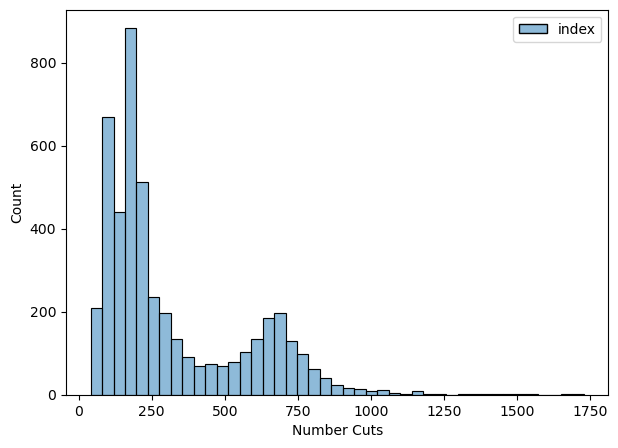

In [48]:
# calculate number of cuts in each serie
cuts = image_df.groupby(["patient_id","series"]).count()

# make histogram.
plt.figure(figsize=(7,5))
sns.histplot(cuts)
plt.xlabel("Number Cuts")
plt.ylabel("Count")
plt.show()

checking to see the distibution of Injury

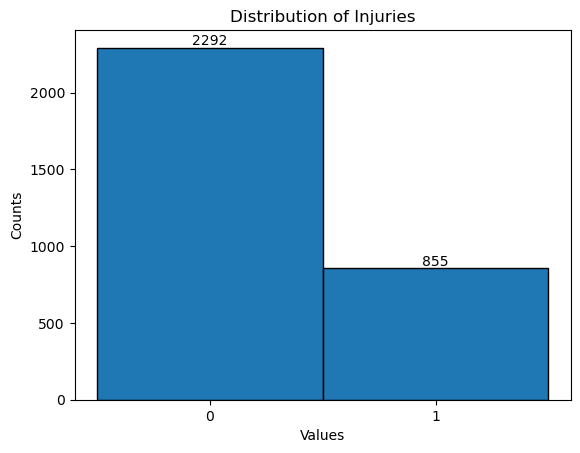

In [16]:
from collections import Counter
# Count the occurrence of each value
counts = Counter(train_df.iloc[:, -1])
# Make the histogram using plt.hist, bins must be integer
plt.hist(train_df.iloc[:, -1], bins=[-0.5, 0.5, 1.5], edgecolor='black')

plt.title('Distribution of Injuries')
plt.xlabel('Values')
plt.ylabel('Counts')

# Display counts above bars
for x, y in counts.items():
    plt.text(x, y, str(y), ha='center', va='bottom')

plt.xticks([0, 1])
plt.show()

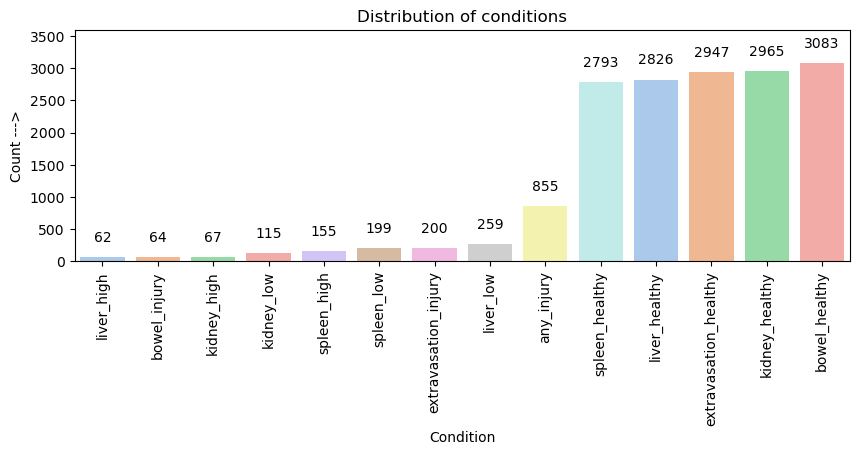

In [17]:
organ_columns = ['bowel', 'extravasation', 'kidney', 'liver', 'spleen']

   
organ_counts = pd.DataFrame({
    'Organ': train_df.columns[1:],
    'count': [train_df[column].sum() for column in train_df.columns[1:]]
})

plt.figure(figsize=(10, 3))
palette = sns.color_palette("pastel", len(organ_counts['Organ'].unique()))
ax = sns.barplot(data=organ_counts.sort_values(by='count'), x='Organ', y='count', palette=palette, hue="Organ")
for p in ax.patches:
    ax.annotate(format(p.get_height(), '.0f'), 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha = 'center', va = 'bottom', 
                xytext = (0, 9), 
                textcoords = 'offset points')
plt.xticks(rotation=90)
plt.title("Distribution of conditions")
plt.xlabel("Condition")
plt.ylim((0,3600))
plt.ylabel("Count --->")
plt.show()

In [18]:
image_labels_df.shape

(12029, 4)

In [19]:
image_labels_df['injury_name'].value_counts()

injury_name
Active_Extravasation    6370
Bowel                   5659
Name: count, dtype: int64

In [20]:
image_labels_df['patient_id'].nunique()

246

In [21]:
image_labels_df.head(2)

,patient_id,series_id,instance_number,injury_name
0,10004,21057,362,Active_Extravasation
1,10004,21057,363,Active_Extravasation


In [46]:
# # reading dcm files
# file_1 = [os.path.join(data_dir,'train_images/10004/21057/') + file
#          for file in os.listdir(os.path.join(data_dir,'train_images/10004/21057'))]
# file_2 = [os.path.join(data_dir,'train_images/10004/51033/') + file
#          for file in os.listdir(os.path.join(data_dir,'train_images/10004/51033'))]
# # Read the dcm files and extract the pixel arrays
# dcmis = [pydicom.dcmread(f).pixel_array for f in file_1]

# # Create a figure and axis for plotting
# fig, ax = plt.subplots(figsize=(10, 8))

# # Plot the first frame and keep the plot object for later
# im = ax.imshow(dcmis[0], cmap=plt.cm.bone)


# # create update function that iterates over your images
# def update(i):
#     im.set_array(dcmis[i])

# ani = animation.FuncAnimation(fig, update, frames=range(len(dcmis)), repeat=True)

# # Show the animation
# # HTML(ani.to_jshtml())

# # Assuming you have the HTML content in a variable 'html_content'
# html_content = ani.to_jshtml()

# # Specify the file path and name
# file_path = 'output.html'

# # Write the HTML content to the file
# with open(file_path, 'w') as file:
#     file.write(html_content)

In [55]:
series_meta_df.head()

,patient_id,series_id,aortic_hu,incomplete_organ
0,10004,21057,146.00,0
1,10004,51033,454.75,0
2,10005,18667,187.00,0
3,10007,47578,329.00,0
4,10026,29700,327.00,0


In [71]:
# reading .png files
# patient =  series_meta_df["patient_id"][0]
# series = series_meta_df["series_id"][0]
# pattern = "^" + str(patient) + "_"+ str(series) + "_"
# bool(re.match(pattern, list_img[0]))
# list_img[0]
# print(pattern)
# print(list_img[0])
patient =  series_meta_df["patient_id"][5]
series = series_meta_df["series_id"][5]
pattern = "^" + str(patient) + "_"+ str(series) + "_"
file_2 = [file for file in list_img if bool(re.match(pattern, file))]
len(file_2)

169

In [82]:
# reading .png files
# first sample
patient =  series_meta_df["patient_id"][0]
series = series_meta_df["series_id"][0]
pattern = "^" + str(patient) + "_"+ str(series) + "_"
file_1 = [os.path.join(data_dir,'train_images/') + file for file in list_img if bool(re.match(pattern, file))]
# second sample
patient =  series_meta_df["patient_id"][5]
series = series_meta_df["series_id"][5]
pattern = "^" + str(patient) + "_"+ str(series) + "_"
file_2 = [os.path.join(data_dir,'train_images/') + file for file in list_img if bool(re.match(pattern, file))]

Animation size has reached 21184954 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


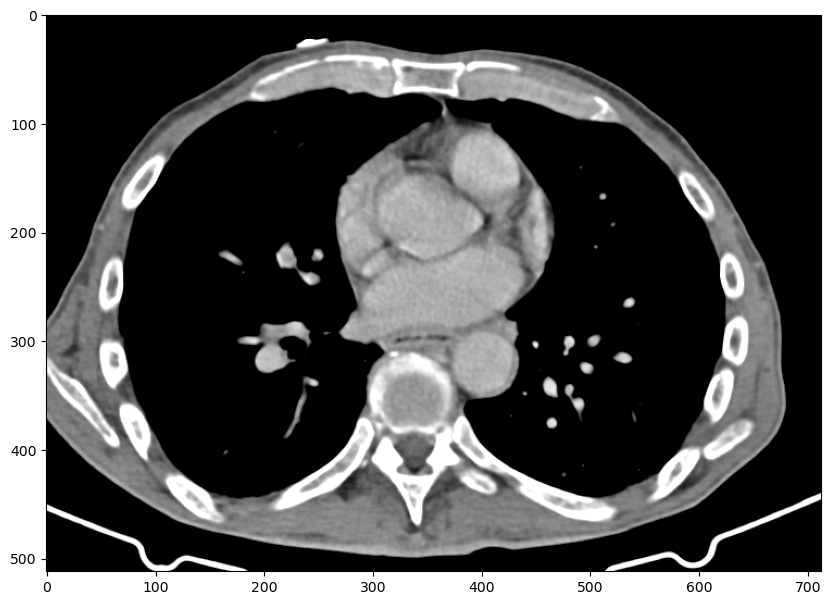

In [85]:
# Read the PNG files and extract the pixel arrays
png_images = [Image.open(f) for f in file_2]
pixel_arrays = [np.array(img.convert('L')) for img in png_images]

# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(10, 8))

# Plot the first frame and keep the plot object for later
im = ax.imshow(pixel_arrays[0], cmap='gray')

# Define an update function that iterates over your images
def update(i):
    im.set_array(pixel_arrays[i])
    return [im]

# Create an animation object
ani = animation.FuncAnimation(fig, update, frames=range(len(pixel_arrays)), repeat=True)

# Show the animation
HTML(ani.to_jshtml())



In [ ]:
# # Writing a HTML file
# html_content = ani.to_jshtml()

# # Specify the file path and name
# file_path = 'output.html'

# # Write the HTML content to the file
# with open(file_path, 'w') as file:
#     file.write(html_content)

In [24]:
# sample_files = file_1 + file_2

# sample_vid = [pydicom.dcmread(file).pixel_array for file in tqdm.tqdm(sample_files , total = len(sample_files))]

# fig, ax = plt.subplots()
# im = ax.imshow(sample_vid[0], cmap=plt.cm.bone)

# update = lambda i : im.set_array(sample_vid[i])

# ani = animation.FuncAnimation(fig, update, frames=range(len(sample_vid)), repeat=True)

# HTML(ani.to_jshtml())